First, we install all these packagaes

In [103]:
#!pip install scanpy
#!pip install anndata
#!pip3 install igraph
#!pip install celltypist
#!pip install decoupler
#!pip install fa2-modified
#!pip install louvain
#!pip install scvelo

In [104]:
import scanpy as sc
import anndata as ad
import numpy as np
import scvelo as scv


Loading the datasets and verifying few details 

In [105]:
# Mock
mock_adata = sc.read_10x_mtx('GSE166766/mock/')
print(f"Mock Adata shape: {mock_adata.shape}")

# 1dpi
day1_adata = sc.read_10x_mtx('GSE166766/1dpi/')
print(f"1dpi Adata shape: {day1_adata.shape}")

# 2dpi
day2_adata = sc.read_10x_mtx('GSE166766/2dpi/')
print(f"2dpi Adata shape: {day2_adata.shape}")

# 3dpi
day3_adata = sc.read_10x_mtx('GSE166766/3dpi/')
print(f"3dpi Adata shape: {day3_adata.shape}")


# 2. Adding Condition Columns (.obs) 

# Add 'condition' to the obs DataFrame
mock_adata.obs['condition'] = 'Mock'
day1_adata.obs['condition'] = 'Day1'
day2_adata.obs['condition'] = 'Day2'
day3_adata.obs['condition'] = 'Day3'





Mock Adata shape: (22609, 33539)
1dpi Adata shape: (11834, 33539)
2dpi Adata shape: (14695, 33539)
3dpi Adata shape: (28530, 33539)


In [106]:
# 2. Adding Condition Columns (.obs) 

# Add 'condition' to the obs DataFrame
mock_adata.obs['condition'] = 'Mock'
day1_adata.obs['condition'] = 'Day1'
day2_adata.obs['condition'] = 'Day2'
day3_adata.obs['condition'] = 'Day3'

# Check the first few entries for the mock sample
print("\n--- Mock Sample .obs head (with new 'condition' column) ---")
print(mock_adata.obs.head())

# Check the first few entries for the day1 sample
print("\n--- day 1 .obs head (with new 'condition' column) ---")
print(day1_adata.obs.head())

# Check the first few entries for the day2 sample
print("\n--- day 2 .obs head (with new 'condition' column) ---")
print(day2_adata.obs.head())

# Check the first few entries for the day3 sample
print("\n--- day 3 .obs head (with new 'condition' column) ---")
print(day3_adata.obs.head())







--- Mock Sample .obs head (with new 'condition' column) ---
                   condition
AAACCCACAAGCCATT-1      Mock
AAACCCACAGACACAG-1      Mock
AAACCCACAGAGGAAA-1      Mock
AAACCCACAGGACAGT-1      Mock
AAACCCACAGTTCTAG-1      Mock

--- day 1 .obs head (with new 'condition' column) ---
                   condition
AAACCCACAACCGCTG-1      Day1
AAACCCACAATTGAAG-1      Day1
AAACCCACACACAGAG-1      Day1
AAACCCACATCTAACG-1      Day1
AAACCCAGTCCCGGTA-1      Day1

--- day 2 .obs head (with new 'condition' column) ---
                   condition
AAACCCACACAACATC-1      Day2
AAACCCACAGATTTCG-1      Day2
AAACCCACAGCTGTGC-1      Day2
AAACCCACAGTAGAAT-1      Day2
AAACCCAGTCACTGAT-1      Day2

--- day 3 .obs head (with new 'condition' column) ---
                   condition
AAACCCACAATGCTCA-1      Day3
AAACCCACACAACATC-1      Day3
AAACCCACAGAATGTA-1      Day3
AAACCCACATAATCGC-1      Day3
AAACCCACATGAATCC-1      Day3


In [107]:
"""To check var meta data, which contains genes (variables)- you can see meta data , and some realted info to gene- like no of cells, type of gene etc """

print(mock_adata.var.head())
print(day1_adata.var.head())
print(day2_adata.var.head())
print(day3_adata.var.head())

                    gene_ids    feature_types
MIR1302-2HG  ENSG00000243485  Gene Expression
FAM138A      ENSG00000237613  Gene Expression
OR4F5        ENSG00000186092  Gene Expression
AL627309.1   ENSG00000238009  Gene Expression
AL627309.3   ENSG00000239945  Gene Expression
                    gene_ids    feature_types
MIR1302-2HG  ENSG00000243485  Gene Expression
FAM138A      ENSG00000237613  Gene Expression
OR4F5        ENSG00000186092  Gene Expression
AL627309.1   ENSG00000238009  Gene Expression
AL627309.3   ENSG00000239945  Gene Expression
                    gene_ids    feature_types
MIR1302-2HG  ENSG00000243485  Gene Expression
FAM138A      ENSG00000237613  Gene Expression
OR4F5        ENSG00000186092  Gene Expression
AL627309.1   ENSG00000238009  Gene Expression
AL627309.3   ENSG00000239945  Gene Expression
                    gene_ids    feature_types
MIR1302-2HG  ENSG00000243485  Gene Expression
FAM138A      ENSG00000237613  Gene Expression
OR4F5        ENSG00000186092  Gene

In [108]:
#Removing duplicates from var and obs- this is just a good practice for older datasets, nothing else

# Mock Sample
mock_adata.var_names_make_unique()
mock_adata.obs_names_make_unique()
print(mock_adata)

# Day 1 Sample
day1_adata.var_names_make_unique()
day1_adata.obs_names_make_unique() 
print(day1_adata)
# Day 2 Sample
day2_adata.var_names_make_unique()
day2_adata.obs_names_make_unique()
print(day2_adata)

# Day 3 Sample
day3_adata.var_names_make_unique()
day3_adata.obs_names_make_unique() 
print(day3_adata)

AnnData object with n_obs × n_vars = 22609 × 33539
    obs: 'condition'
    var: 'gene_ids', 'feature_types'
AnnData object with n_obs × n_vars = 11834 × 33539
    obs: 'condition'
    var: 'gene_ids', 'feature_types'
AnnData object with n_obs × n_vars = 14695 × 33539
    obs: 'condition'
    var: 'gene_ids', 'feature_types'
AnnData object with n_obs × n_vars = 28530 × 33539
    obs: 'condition'
    var: 'gene_ids', 'feature_types'


In [109]:
#Just inspection can skip 
mock_adata.obs.columns

print(mock_adata)

AnnData object with n_obs × n_vars = 22609 × 33539
    obs: 'condition'
    var: 'gene_ids', 'feature_types'


#Quaity Control 

In [110]:
# --- Basic QC before filtering: Identification of low-quality or dying cells ---

# mock dataset
mock_adata.var["MT"] = mock_adata.var_names.str.startswith("MT-")
mock_adata.var["RIBO"] = mock_adata.var_names.str.startswith(("RPS","RPL"))
mock_adata.var["HB"] = mock_adata.var_names.str.contains(("^HB[^(P)]"), regex=True) 
sc.pp.calculate_qc_metrics(
    mock_adata, qc_vars=["MT", 'RIBO', 'HB'], inplace=True, log1p=True
)

# 1dpi dataset
day1_adata.var["MT"] = day1_adata.var_names.str.startswith("MT-")
day1_adata.var["RIBO"] = day1_adata.var_names.str.startswith(("RPS","RPL"))
day1_adata.var["HB"] = day1_adata.var_names.str.contains(("^HB[^(P)]"), regex=True)
sc.pp.calculate_qc_metrics(
    day1_adata, qc_vars=["MT", 'RIBO', 'HB'], inplace=True, log1p=True
)

# 2dpi dataset
day2_adata.var["MT"] = day2_adata.var_names.str.startswith("MT-")
day2_adata.var["RIBO"] = day2_adata.var_names.str.startswith(("RPS","RPL"))
day2_adata.var["HB"] = day2_adata.var_names.str.contains(("^HB[^(P)]"), regex=True)
sc.pp.calculate_qc_metrics(
    day2_adata, qc_vars=["MT", 'RIBO', 'HB'], inplace=True, log1p=True
)

# 3dpi dataset
day3_adata.var["MT"] = day3_adata.var_names.str.startswith("MT-")
day3_adata.var["RIBO"] = day3_adata.var_names.str.startswith(("RPS","RPL"))
day3_adata.var["HB"] = day3_adata.var_names.str.contains(("^HB[^(P)]"), regex=True)
sc.pp.calculate_qc_metrics(
    day3_adata, qc_vars=["MT", 'RIBO', 'HB'], inplace=True, log1p=True
)

# Verification
print("New QC metrics added to mock_adata.obs:")
print(mock_adata.obs.columns.tolist())

New QC metrics added to mock_adata.obs:
['condition', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_MT', 'log1p_total_counts_MT', 'pct_counts_MT', 'total_counts_RIBO', 'log1p_total_counts_RIBO', 'pct_counts_RIBO', 'total_counts_HB', 'log1p_total_counts_HB', 'pct_counts_HB']


... storing 'condition' as categorical
... storing 'feature_types' as categorical


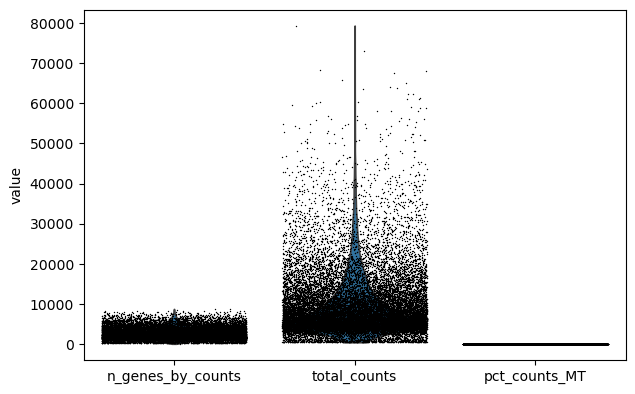

... storing 'condition' as categorical
... storing 'feature_types' as categorical


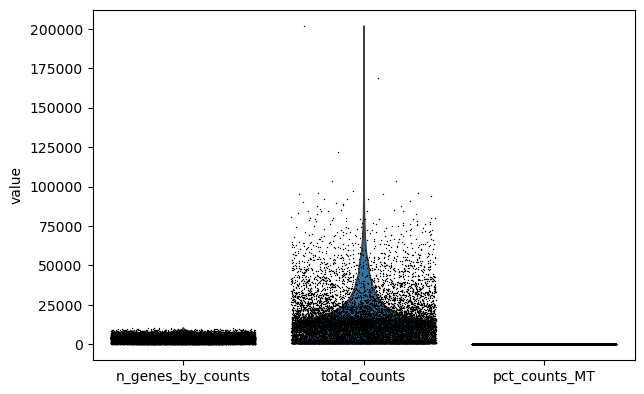

... storing 'condition' as categorical
... storing 'feature_types' as categorical


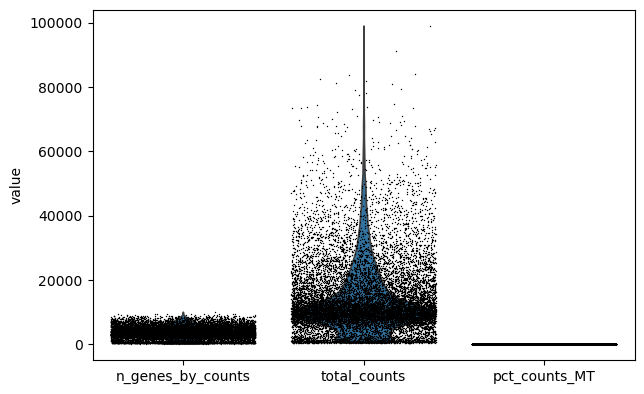

... storing 'condition' as categorical
... storing 'feature_types' as categorical


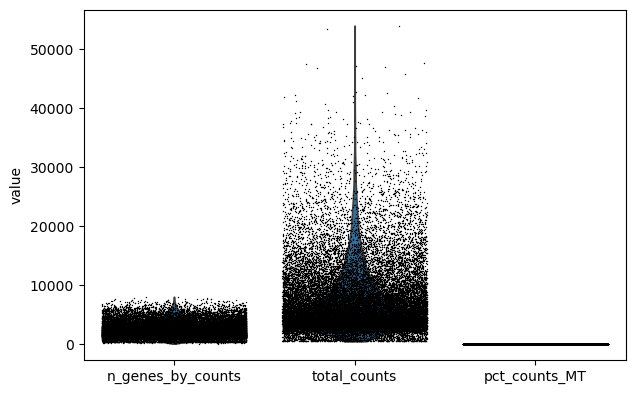

In [111]:
# --- Violin Plots for Quality Control Metrics ---

# mock dataset
sc.pl.violin(
    mock_adata,
    ["n_genes_by_counts", 'total_counts', 'pct_counts_MT'],
    jitter=0.4,
    multi_panel=False
)

# 1dpi dataset
sc.pl.violin(
    day1_adata, # Corrected variable name
    ["n_genes_by_counts", 'total_counts', 'pct_counts_MT'],
    jitter=0.4,
    multi_panel=False
)

# 2dpi dataset
sc.pl.violin(
    day2_adata, # Corrected variable name
    ["n_genes_by_counts", 'total_counts', 'pct_counts_MT'],
    jitter=0.4,
    multi_panel=False
)

# 3dpi dataset
sc.pl.violin(
    day3_adata, # Corrected variable name
    ["n_genes_by_counts", 'total_counts', 'pct_counts_MT'],
    jitter=0.4,
    multi_panel=False
)

--- Mock Sample QC Scatter ---


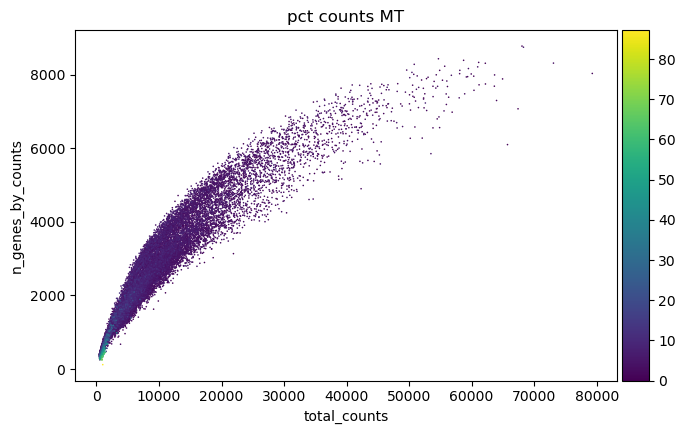

--- Day 1 Sample QC Scatter ---


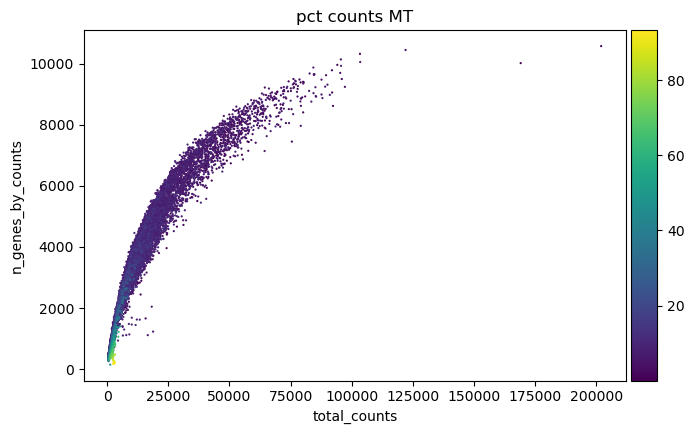

--- Day 2 Sample QC Scatter ---


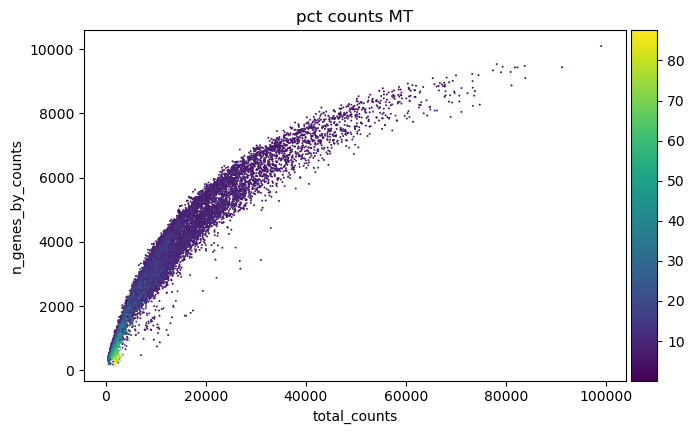

--- Day 3 Sample QC Scatter ---


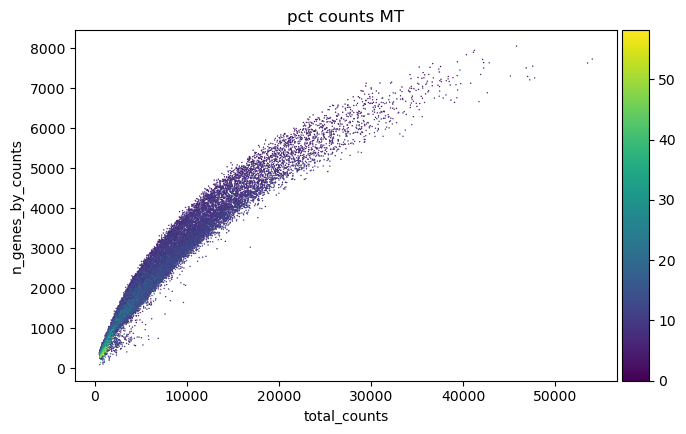

In [112]:
# Scatter plots for QC verification

# mock dataset
print("--- Mock Sample QC Scatter ---")
sc.pl.scatter(mock_adata, x="total_counts", y="n_genes_by_counts", color="pct_counts_MT")

# 1dpi dataset
print("--- Day 1 Sample QC Scatter ---")
sc.pl.scatter(day1_adata, x="total_counts", y="n_genes_by_counts", color="pct_counts_MT")

# 2dpi dataset
print("--- Day 2 Sample QC Scatter ---")
sc.pl.scatter(day2_adata, x="total_counts", y="n_genes_by_counts", color="pct_counts_MT")

# 3dpi dataset
print("--- Day 3 Sample QC Scatter ---")
sc.pl.scatter(day3_adata, x="total_counts", y="n_genes_by_counts", color="pct_counts_MT")

In [113]:
#Filtering Cells with High Mitochondrial Content (< 10%) 

#Mock
initial_cells_mock = mock_adata.n_obs
# Filtering condition: pct_counts_MT < 10
mock_adata = mock_adata[mock_adata.obs['pct_counts_MT'] < 10, :].copy() 
print(f"Mock Adata: Filtered from {initial_cells_mock} cells down to {mock_adata.n_obs} cells.")


#Day1
initial_cells_day1 = day1_adata.n_obs
day1_adata = day1_adata[day1_adata.obs['pct_counts_MT'] < 10, :].copy() 
print(f"Day 1 Adata: Filtered from {initial_cells_day1} cells down to {day1_adata.n_obs} cells.")


#Day2
initial_cells_day2 = day2_adata.n_obs
day2_adata = day2_adata[day2_adata.obs['pct_counts_MT'] < 10, :].copy() 
print(f"Day 2 Adata: Filtered from {initial_cells_day2} cells down to {day2_adata.n_obs} cells.")


#Day3
initial_cells_day3 = day3_adata.n_obs
day3_adata = day3_adata[day3_adata.obs['pct_counts_MT'] < 10, :].copy() 
print(f"Day 3 Adata: Filtered from {initial_cells_day3} cells down to {day3_adata.n_obs} cells.")

Mock Adata: Filtered from 22609 cells down to 21825 cells.
Day 1 Adata: Filtered from 11834 cells down to 9314 cells.
Day 2 Adata: Filtered from 14695 cells down to 11958 cells.
Day 3 Adata: Filtered from 28530 cells down to 19746 cells.


In [114]:
# --- Normalization and Log-Transformation on Individual Samples ---

# Mock Sample
# Save raw counts
mock_adata.layers["counts"] = mock_adata.X.copy()
# Normalize total counts to 10,000
sc.pp.normalize_total(mock_adata, target_sum=1e4)
# Log-transform
sc.pp.log1p(mock_adata)
print("Mock Adata Normalized and Log-Transformed.")

#  Day 1 Sample
# Save raw counts
day1_adata.layers["counts"] = day1_adata.X.copy()
# Normalize total counts to 10,000
sc.pp.normalize_total(day1_adata, target_sum=1e4)
# Log-transform
sc.pp.log1p(day1_adata)
print("Day 1 Adata Normalized and Log-Transformed.")

# Day 2 Sample
# Save raw counts
day2_adata.layers["counts"] = day2_adata.X.copy()
# Normalize total counts to 10,000
sc.pp.normalize_total(day2_adata, target_sum=1e4)
# Log-transform
sc.pp.log1p(day2_adata)
print("Day 2 Adata Normalized and Log-Transformed.")

# Day 3 Sample
# Save raw counts
day3_adata.layers["counts"] = day3_adata.X.copy()
# Normalize total counts to 10,000
sc.pp.normalize_total(day3_adata, target_sum=1e4)
# Log-transform
sc.pp.log1p(day3_adata)
print("Day 3 Adata Normalized and Log-Transformed.")

Mock Adata Normalized and Log-Transformed.
Day 1 Adata Normalized and Log-Transformed.
Day 2 Adata Normalized and Log-Transformed.
Day 3 Adata Normalized and Log-Transformed.


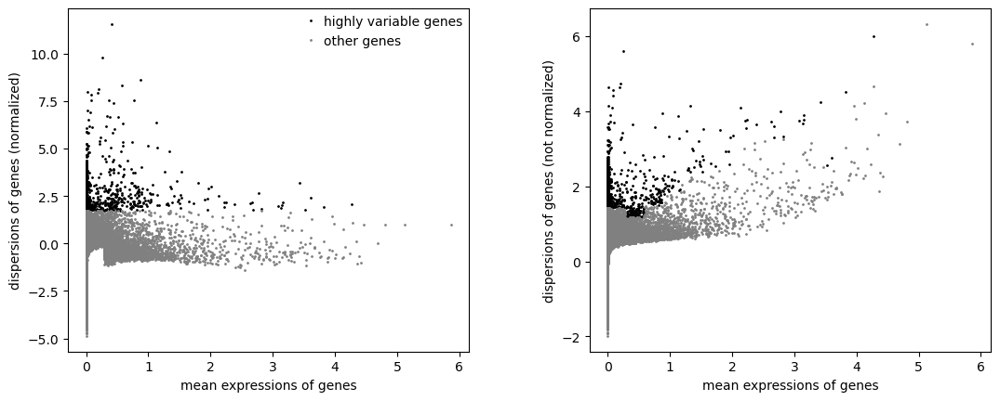

In [115]:
#Showing the Normalisation plots and also 

# 1. Mock Sample
sc.pp.highly_variable_genes(mock_adata, n_top_genes=1000)
sc.pl.highly_variable_genes(mock_adata)





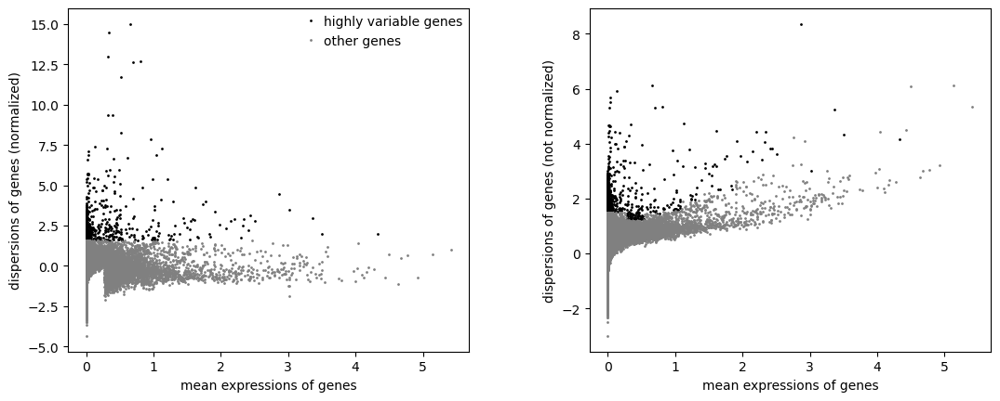

In [116]:


# 2. Day 1 Sample
sc.pp.highly_variable_genes(day1_adata, n_top_genes=1000)
sc.pl.highly_variable_genes(day1_adata)
plt.show()



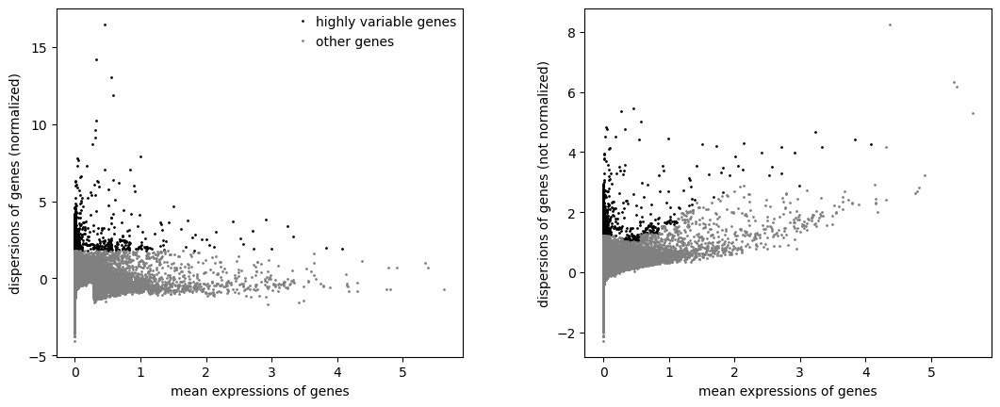

In [117]:


# 3. Day 2 Sample
sc.pp.highly_variable_genes(day2_adata, n_top_genes=1000)
sc.pl.highly_variable_genes(day2_adata)
plt.show()



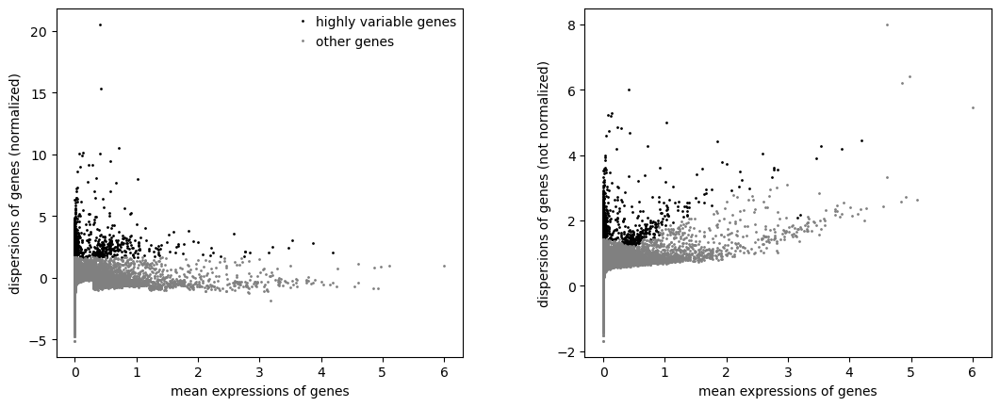

In [118]:


# 4. Day 3 Sample
sc.pp.highly_variable_genes(day3_adata, n_top_genes=1000)
sc.pl.highly_variable_genes(day3_adata)
plt.show()

PCA for the 4 samples


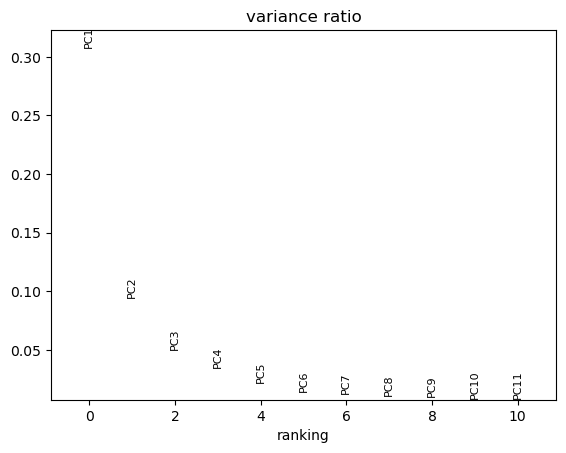

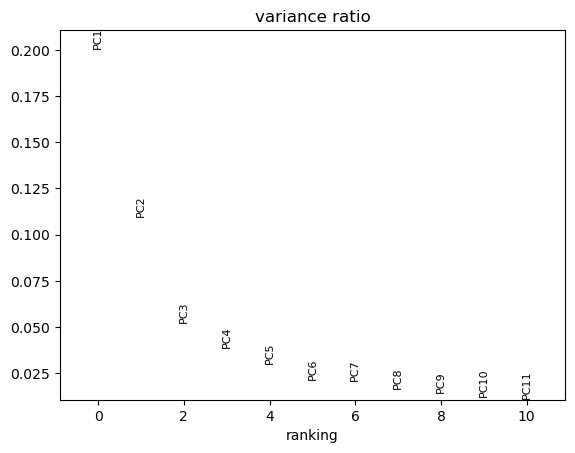

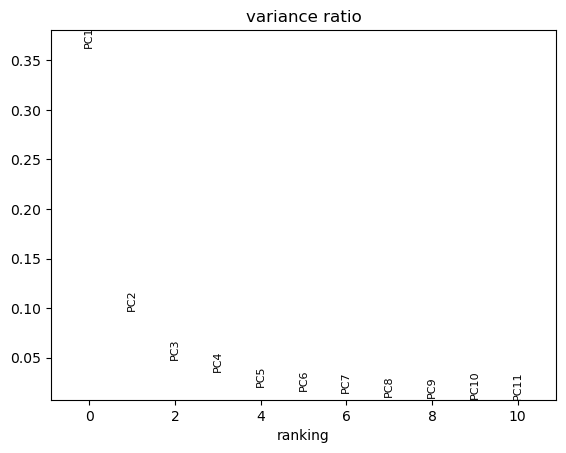

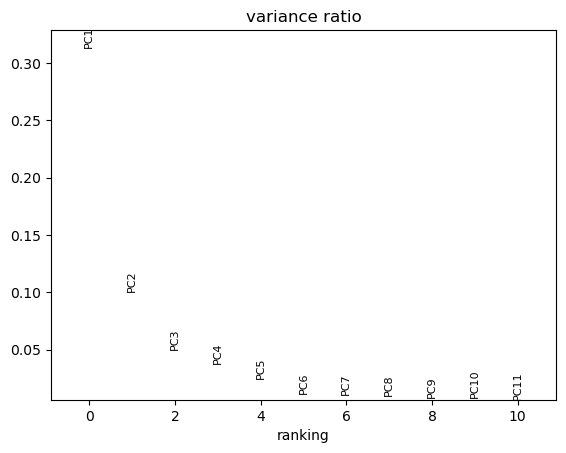

In [119]:

sc.tl.pca(mock_adata)
sc.tl.pca(day1_adata)
sc.tl.pca(day2_adata)
sc.tl.pca(day3_adata)


sc.pl.pca_variance_ratio(mock_adata, n_pcs=10, log=False)
sc.pl.pca_variance_ratio(day1_adata, n_pcs=10, log=False)
sc.pl.pca_variance_ratio(day2_adata, n_pcs=10, log=False)
sc.pl.pca_variance_ratio(day3_adata, n_pcs=10, log=False)

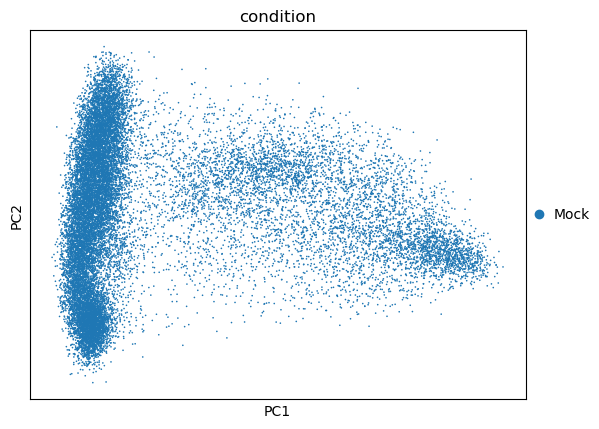

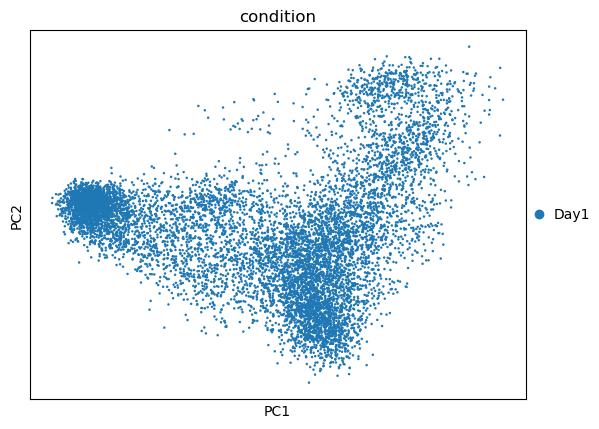

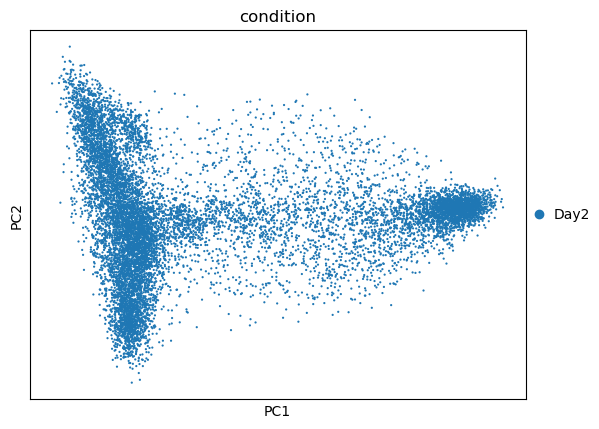

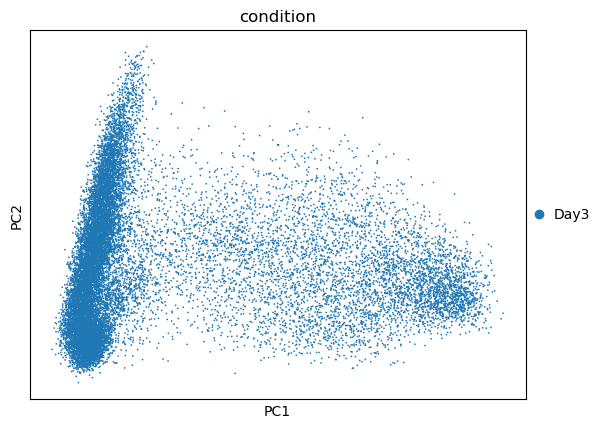

In [120]:

sc.pl.pca(mock_adata,
          color=['condition'],
          cmap="coolwarm"
)

sc.pl.pca(day1_adata,
          color=['condition'],
          cmap="coolwarm"
)
sc.pl.pca(day2_adata,
          color=['condition'],
          cmap="coolwarm"
)
sc.pl.pca(day3_adata,
          color=['condition'],
          cmap="coolwarm"
)

What the pattern means:

Dense cluster (left side):

Main population of mock cells
Likely the major cell types (ciliated, basal, club, etc.)
Healthy, normal bronchial epithelial cells

Scattered points (right side):

Either:

Rare cell types (ionocytes, tuft cells, neuroendocrine)
Transitional cell states
Lower quality cells
Technical outliers


Gradient spreading:

PC1 (horizontal) captures the main variation
Probably cell type differences
PC2 (vertical) captures secondary variation

 Clustering
 #Function: sc.pp.neighbors() = "compute neighborhood graph"

 what it does 

Takes the PCA results (principal components you computed earlier)
For each cell, finds its k nearest neighbors (default k=15)
Creates a graph/network connecting similar cells

Why you need this:

 Required before UMAP (UMAP uses this graph)
 Required before clustering (clustering uses this graph)
Defines which cells are "similar" to each other

UMAP = Uniform Manifold Approximation and Projection
what it does 

Takes the neighbor graph from Step 1
Tries to project high-dimensional data (PCA space) into 2D
Preserves the local neighborhood structure
Creates x,y coordinates for each cell

We are looking at ACE2 and UMAP because 

Running Neighbor Graph and UMAP Projection...
 Neighbor graphs and UMAP coordinates calculated for all four samples.

Plotting UMAP visualizations...


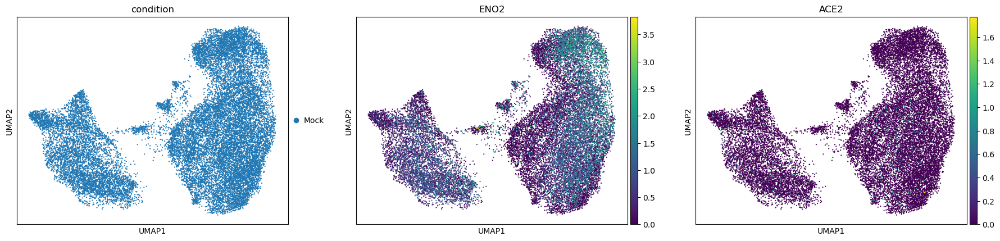

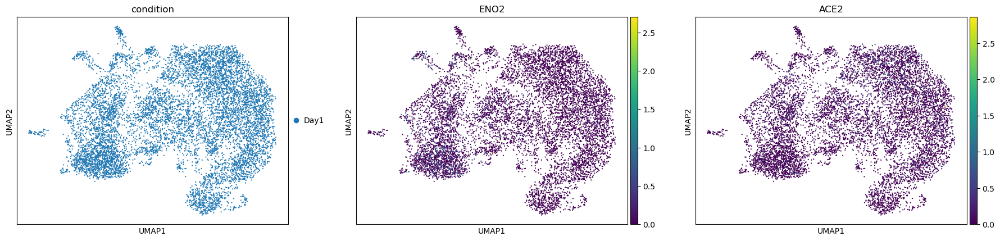

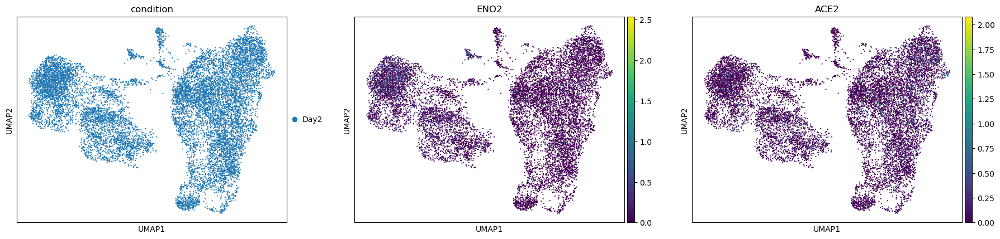

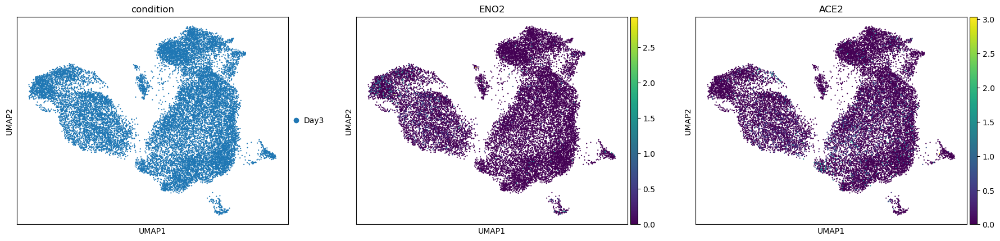

In [121]:
# --- 1. Graph Calculation and UMAP Projection (Corrected Variables) ---
print("Running Neighbor Graph and UMAP Projection...")

# Mock
sc.pp.neighbors(mock_adata)
sc.tl.umap(mock_adata)
# Day 1
sc.pp.neighbors(day1_adata)
sc.tl.umap(day1_adata)
# Day 2
sc.pp.neighbors(day2_adata)
sc.tl.umap(day2_adata)
# Day 3
sc.pp.neighbors(day3_adata)
sc.tl.umap(day3_adata)

print(" Neighbor graphs and UMAP coordinates calculated for all four samples.")

# --- 2. UMAP Plotting (Corrected Variables) ---
print("\nPlotting UMAP visualizations...")

# Mock Sample UMAP
sc.pl.umap(mock_adata, color=['condition', 'ENO2','ACE2'], size=10)

# Day 1 Sample UMAP
sc.pl.umap(day1_adata, color=['condition', 'ENO2','ACE2'], size=10)

# Day 2 Sample UMAP
sc.pl.umap(day2_adata, color=['condition', 'ENO2','ACE2'], size=10)

# Day 3 Sample UMAP
sc.pl.umap(day3_adata, color=['condition', 'ENO2','ACE2'], size=10)

Based on these UMAP visualizations alone:What we CAN conclude:

ENO2 shows broad, stable expression across all time points
ACE2 shows low baseline expression in bronchial epithelial cells
Visual inspection suggests subtle changes in ACE2, but not dramatic
Both genes are detectable in the dataset

In [122]:
# --- Leiden Clustering (Corrected Variables) ---
print("Running Leiden Clustering on all samples...")

# Mock
sc.tl.leiden(mock_adata, flavor="igraph", n_iterations=10, key_added="leiden_res_0_25", resolution=0.25)
# Day 1
sc.tl.leiden(day1_adata, flavor="igraph", n_iterations=10, key_added="leiden_res_0_25", resolution=0.25)
# Day 2
sc.tl.leiden(day2_adata, flavor="igraph", n_iterations=10, key_added="leiden_res_0_25", resolution=0.25)
# Day 3
sc.tl.leiden(day3_adata, flavor="igraph", n_iterations=10, key_added="leiden_res_0_25", resolution=0.25)

print("✅ Clustering complete. Results stored in '.obs' under 'leiden_res_0_25'.")

Running Leiden Clustering on all samples...
✅ Clustering complete. Results stored in '.obs' under 'leiden_res_0_25'.



Plotting UMAP visualizations colored by Leiden clusters...


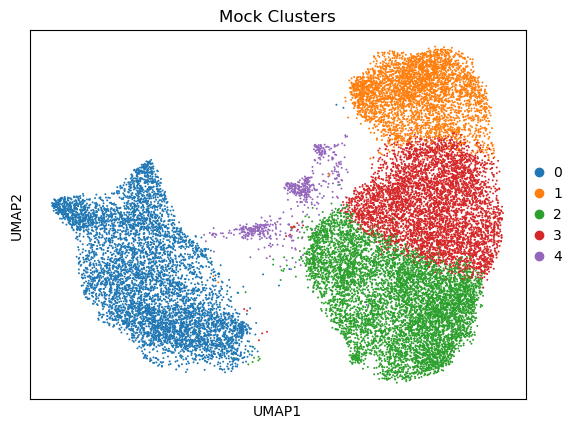

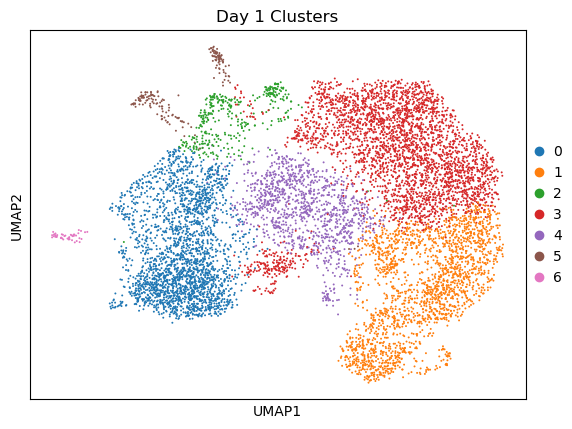

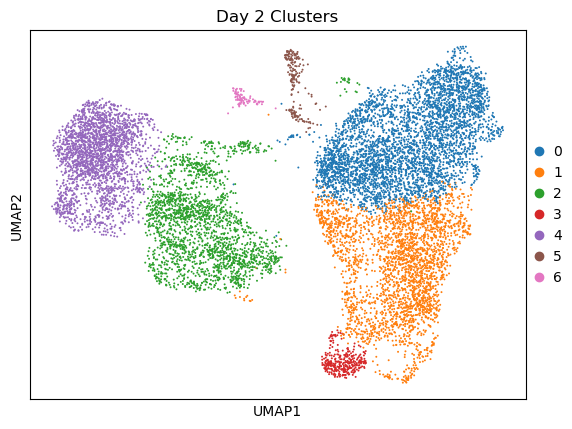

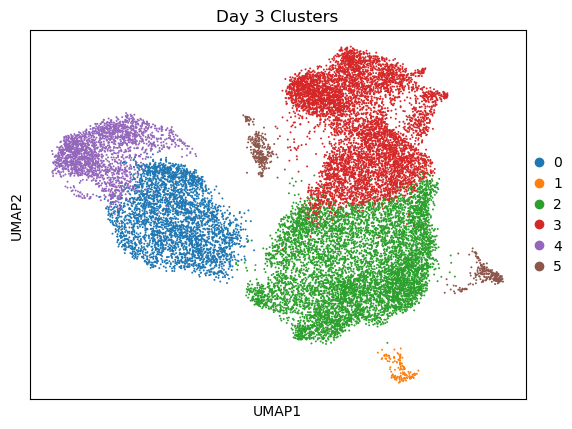

In [123]:
# --- UMAP Plotting by Cluster (Corrected Variables) ---
print("\nPlotting UMAP visualizations colored by Leiden clusters...")

# Mock Sample UMAP
sc.pl.umap(mock_adata, color=["leiden_res_0_25"], size=8, title='Mock Clusters')

# Day 1 Sample UMAP
sc.pl.umap(day1_adata, color=["leiden_res_0_25"], size=8, title='Day 1 Clusters')

# Day 2 Sample UMAP
sc.pl.umap(day2_adata, color=["leiden_res_0_25"], size=8, title='Day 2 Clusters')

# Day 3 Sample UMAP
sc.pl.umap(day3_adata, color=["leiden_res_0_25"], size=8, title='Day 3 Clusters')

if you lok at the images 

Mock: Clear, well-separated clusters
Day 1: More fragmented, some overlap
Day 2: Reorganizing, different spatial arrangement
Day 3: New organization, one massive clusterInterpretation:

What this means is- 
Cell states are changing over infection
Transcriptional profiles shifting
Cells adopting new states/phenotypes


Plotting UMAP visualizations colored by Leiden clusters and ACE2 expression...


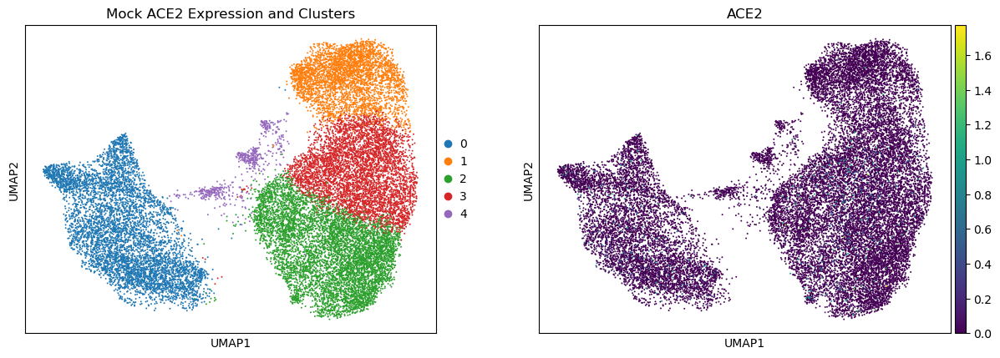

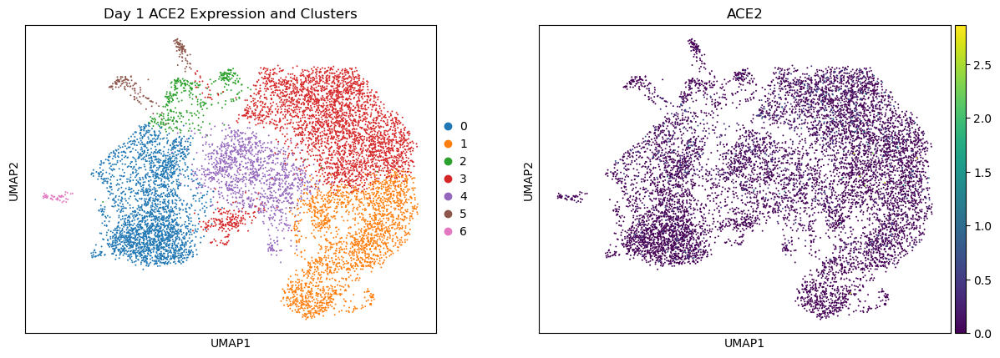

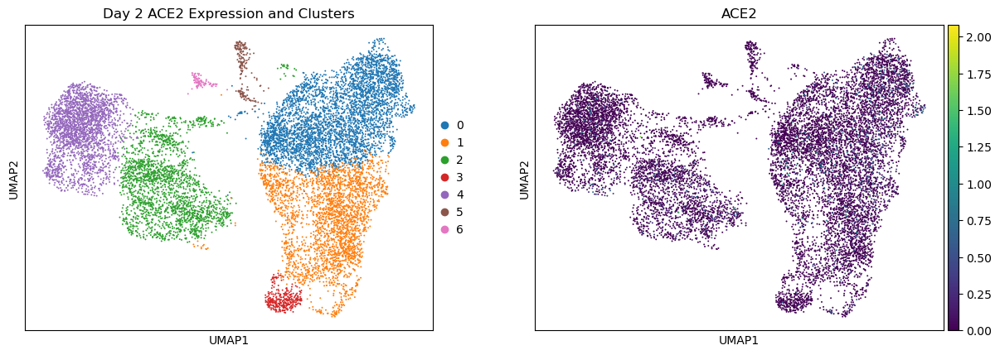

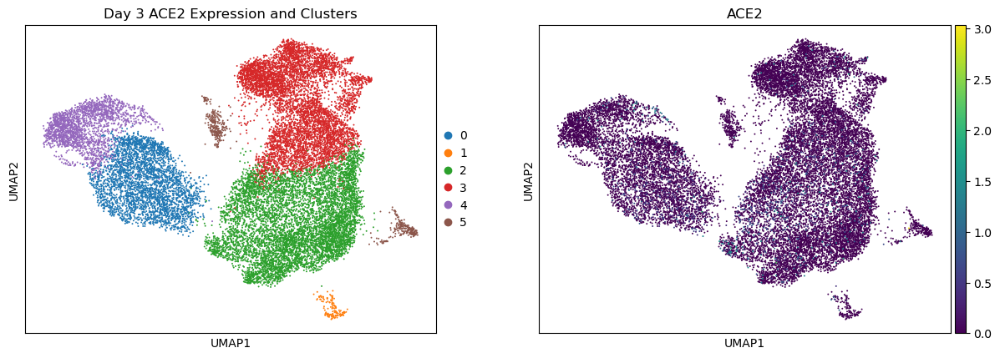

In [124]:
# --- UMAP Plotting (Corrected Variables) ---
print("Plotting UMAP visualizations colored by Leiden clusters and ACE2 expression...")

# Mock Sample UMAP
sc.pl.umap(mock_adata, color=["leiden_res_0_25", "ACE2"], size=8, title='Mock ACE2 Expression and Clusters')

# Day 1 Sample UMAP
sc.pl.umap(day1_adata, color=["leiden_res_0_25", "ACE2"], size=8, title='Day 1 ACE2 Expression and Clusters')

# Day 2 Sample UMAP
sc.pl.umap(day2_adata, color=["leiden_res_0_25", "ACE2"], size=8, title='Day 2 ACE2 Expression and Clusters')

# Day 3 Sample UMAP
sc.pl.umap(day3_adata, color=["leiden_res_0_25", "ACE2"], size=8, title='Day 3 ACE2 Expression and Clusters')

At 3 days post-infection, Cluster 3 (the dominant red cluster in the top/center region of the UMAP) shows the highest relative ACE2 expression based on spatial overlap analysis. This cluster represents the largest cell population at Day 3 and spatially corresponds to regions of elevated ACE2 expression

Cell annotation

In [125]:
import decoupler as dc

In [126]:

# Query Omnipath and get PanglaoDB
markers = dc.op.resource(name="PanglaoDB", organism="human")
     

In [127]:
markers.head()

,genesymbol,canonical_marker,cell_type,germ_layer,human,human_sensitivity,human_specificity,mouse,mouse_sensitivity,mouse_specificity,ncbi_tax_id,organ,ubiquitiousness
,,,,,,,,,,,,,
0,A1CF,False,Hepatocytes,Endoderm,True,0.189189,0.004437,True,0.175000,0.000257,9606,Liver,0.002
1,A2APA5,False,Germ cells,Mesoderm,False,0.000000,0.000000,True,0.432927,0.000000,10090,Reproductive,0.004
2,A2M,True,Bergmann glia,Ectoderm,True,0.000000,0.062343,True,0.333333,0.001604,9606,Brain,0.012
3,A3FIN4,False,Mast cells,Mesoderm,False,0.000000,0.000000,True,0.184211,0.000708,10090,Immune system,0.001
4,A4GALT,True,Mast cells,Mesoderm,True,0.000000,0.014133,True,0.000000,0.003023,9606,Immune system,0.005


In [128]:

markers.shape

(8211, 13)

In [129]:

markers['organ'].unique()

array(['Liver', 'Reproductive', 'Brain', 'Immune system', 'Zygote',
       'Kidney', 'Blood', 'Lungs', 'Bone', 'GI tract', nan, 'Vasculature',
       'Pancreas', 'Heart', 'Mammary gland', 'Olfactory system',
       'Connective tissue', 'Epithelium', 'Skeletal muscle', 'Skin',
       'Embryo', 'Smooth muscle', 'Eye', 'Adrenal glands', 'Thyroid',
       'Placenta', 'Thymus', 'Parathyroid glands', 'Oral cavity',
       'Urinary bladder'], dtype=object)

In [130]:
markers = markers[markers["organ"] == "Lungs"]

In [131]:
markers.shape

(196, 13)

In [132]:

# Remove duplicated entries
markers = markers[~markers.duplicated(["cell_type", "genesymbol"])]

# Format because dc only accepts cell_type and genesymbol

markers = markers.rename(columns={"cell_type": "source", "genesymbol": "target"})
markers = markers[["source", "target"]]


markers.head()

,source,target
,,
18,Pulmonary alveolar type II cells,ABCA3
31,Pulmonary alveolar type II cells,ABCD3
172,Pulmonary alveolar type II cells,ADGRF5
186,Airway epithelial cells,ADH7
222,Pulmonary alveolar type I cells,AGER


In [137]:
import anndata as ad

# --- 1. Create Temporary AnnData Objects (Subset to HVGs) ---

# Mock Sample
mock_adata_temp = mock_adata[:, mock_adata.var['highly_variable']].copy()
mock_adata_temp.obs = mock_adata.obs.copy()
mock_adata_temp.obsm['X_umap'] = mock_adata.obsm['X_umap'] 

# Day 1 Sample
day1_adata_temp = day1_adata[:, day1_adata.var['highly_variable']].copy()
day1_adata_temp.obs = day1_adata.obs.copy()
day1_adata_temp.obsm['X_umap'] = day1_adata.obsm['X_umap']

# Day 2 Sample
day2_adata_temp = day2_adata[:, day2_adata.var['highly_variable']].copy()
day2_adata_temp.obs = day2_adata.obs.copy()
day2_adata_temp.obsm['X_umap'] = day2_adata.obsm['X_umap']

# Day 3 Sample
day3_adata_temp = day3_adata[:, day3_adata.var['highly_variable']].copy()
day3_adata_temp.obs = day3_adata.obs.copy()
day3_adata_temp.obsm['X_umap'] = day3_adata.obsm['X_umap']

print(" Temporary HVG-subsetted AnnData objects created.")

# --- 2. Run ULM on the temporary objects with the FILTERED 'markers' ---
print("\nRe-running ULM analysis with LUNG-filtered markers...")

# Mock Sample ULM
dc.mt.ulm(data=mock_adata_temp,
          net=markers,
          tmin=3)

# Day 1 Sample ULM
dc.mt.ulm(data=day1_adata_temp,
          net=markers,
          tmin=3)

# Day 2 Sample ULM
dc.mt.ulm(data=day2_adata_temp,
          net=markers,
          tmin=3)

# Day 3 Sample ULM
dc.mt.ulm(data=day3_adata_temp,
          net=markers,
          tmin=3)

print(" ULM analysis complete on temporary objects (now using Lung-specific marker network).")

# --- 3. Transfer the computed scores back to the original AnnData objects ---

# Transfer 'score_ulm' results
mock_adata.obsm['score_ulm'] = mock_adata_temp.obsm['score_ulm']
day1_adata.obsm['score_ulm'] = day1_adata_temp.obsm['score_ulm']
day2_adata.obsm['score_ulm'] = day2_adata_temp.obsm['score_ulm']
day3_adata.obsm['score_ulm'] = day3_adata_temp.obsm['score_ulm']

print(" ULM scores transferred to original AnnData objects.")

 Temporary HVG-subsetted AnnData objects created.

Re-running ULM analysis with LUNG-filtered markers...
 ULM analysis complete on temporary objects (now using Lung-specific marker network).
 ULM scores transferred to original AnnData objects.


In [140]:
# --- Extracting NEW ULM Scores (Corrected Variables) ---

# Mock Sample
score_mock = dc.pp.get_obsm(mock_adata, key="score_ulm")

# Day 1 Sample
score_1 = dc.pp.get_obsm(day1_adata, key="score_ulm")

# Day 2 Sample
score_2 = dc.pp.get_obsm(day2_adata, key="score_ulm")

# Day 3 Sample
score_3 = dc.pp.get_obsm(day3_adata, key="score_ulm")

print("✅ NEW ULM scores (Lung-filtered) extracted into variables: score_mock, score_1, score_2, score_3.")

✅ NEW ULM scores (Lung-filtered) extracted into variables: score_mock, score_1, score_2, score_3.


In [145]:
# --- Rank genes ---
# mock
mock_adata_gene_rank = dc.tl.rankby_group(score_mock, groupby="leiden_res_0_25", reference="rest", method="t-test_overestim_var")
mock_adata_gene_rank = mock_adata_gene_rank[mock_adata_gene_rank["stat"] > 0]
mock_adata_gene_rank.head(5)

# day 1
one_adata_gene_rank = dc.tl.rankby_group(score_1, groupby="leiden_res_0_25", reference="rest", method="t-test_overestim_var")
one_adata_gene_rank = one_adata_gene_rank[one_adata_gene_rank["stat"] > 0]  # FIXED: changed day1_adata_gene_rank to one_adata_gene_rank
one_adata_gene_rank.head(5)

# day 2
two_adata_gene_rank = dc.tl.rankby_group(score_2, groupby="leiden_res_0_25", reference="rest", method="t-test_overestim_var")
two_adata_gene_rank = two_adata_gene_rank[two_adata_gene_rank["stat"] > 0]  # FIXED: changed day2_adata_gene_rank to two_adata_gene_rank
two_adata_gene_rank.head(5)

# day 3
three_adata_gene_rank = dc.tl.rankby_group(score_3, groupby="leiden_res_0_25", reference="rest", method="t-test_overestim_var")
three_adata_gene_rank = three_adata_gene_rank[three_adata_gene_rank["stat"] > 0]  # FIXED: changed day3_adata_gene_rank to three_adata_gene_rank
three_adata_gene_rank.head(5)

,group,reference,name,stat,meanchange,pval,padj
0,0,rest,Ciliated cells,66.410298,2.270368,0.000000e+00,0.000000e+00
3,0,rest,Pulmonary alveolar type II cells,5.081619,0.132983,3.857014e-07,4.821267e-07
10,2,rest,Airway goblet cells,67.627249,1.151625,0.000000e+00,0.000000e+00
11,2,rest,Pulmonary alveolar type II cells,48.065888,0.922239,0.000000e+00,0.000000e+00
13,2,rest,Alveolar macrophages,25.405348,0.424028,2.526691e-139,3.158363e-139


In [146]:
#mock
top_cell_type_per_group_mock = mock_adata_gene_rank.groupby('group')['name'].apply(lambda x: x.head(1))
display(top_cell_type_per_group_mock.to_dict())

#day 1
top_cell_type_per_group_1 = one_adata_gene_rank.groupby('group')['name'].apply(lambda x: x.head(1))
display(top_cell_type_per_group_1.to_dict())

#day 2
top_cell_type_per_group_2 = two_adata_gene_rank.groupby('group')['name'].apply(lambda x: x.head(1))
display(top_cell_type_per_group_2.to_dict())

#day 3
top_cell_type_per_group_3 = three_adata_gene_rank.groupby('group')['name'].apply(lambda x: x.head(1))
display(top_cell_type_per_group_3.to_dict())

{('0', 0): 'Ciliated cells',
 ('1', 7): 'Pulmonary alveolar type I cells',
 ('2', 14): 'Airway goblet cells',
 ('3', 25): 'Pulmonary alveolar type II cells',
 ('4', 30): 'Ionocytes'}

{('1', 5): 'Pulmonary alveolar type I cells',
 ('3', 15): 'Airway goblet cells',
 ('4', 21): 'Airway goblet cells',
 ('5', 25): 'Ionocytes',
 ('6', 32): 'Alveolar macrophages'}

{('0', 0): 'Pulmonary alveolar type II cells',
 ('1', 20): 'Pulmonary alveolar type I cells',
 ('3', 10): 'Pulmonary alveolar type I cells',
 ('5', 25): 'Ionocytes',
 ('6', 32): 'Airway goblet cells'}

{('0', 0): 'Ciliated cells',
 ('2', 10): 'Airway goblet cells',
 ('3', 18): 'Ionocytes',
 ('4', 20): 'Ciliated cells',
 ('5', 25): 'Ionocytes'}

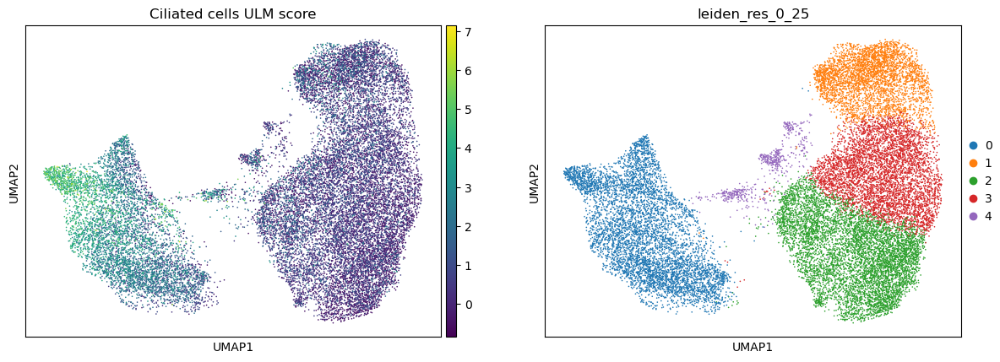

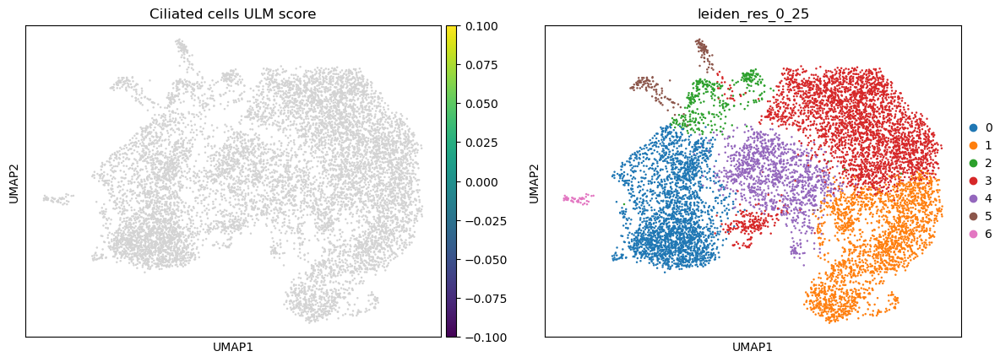

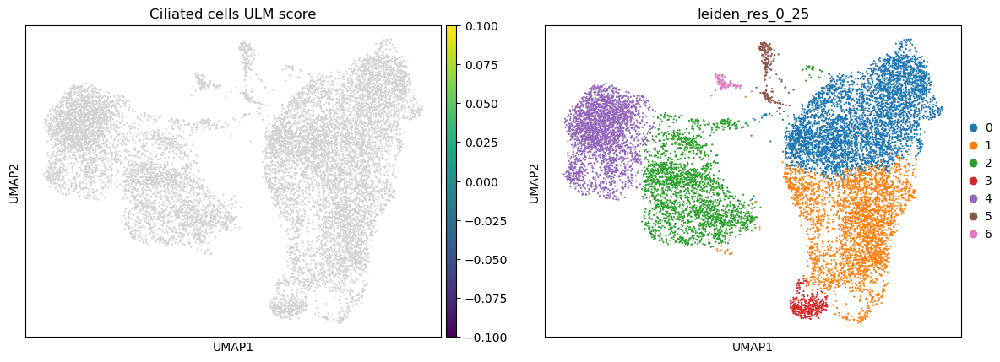

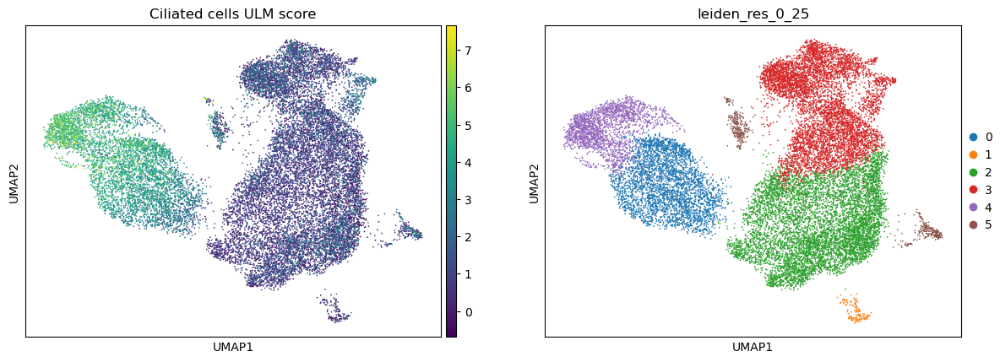

In [148]:
# Add the ULM score for "Ciliated cells" to .obs for plotting
if 'Ciliated cells' in mock_adata.obsm['score_ulm'].columns:
    mock_adata.obs['Ciliated cells ULM score'] = mock_adata.obsm['score_ulm']['Ciliated cells']
else:
    mock_adata.obs['Ciliated cells ULM score'] = np.nan

if 'Ciliated cells' in day1_adata.obsm['score_ulm'].columns:
    day1_adata.obs['Ciliated cells ULM score'] = day1_adata.obsm['score_ulm']['Ciliated cells']
else:
    day1_adata.obs['Ciliated cells ULM score'] = np.nan

if 'Ciliated cells' in day2_adata.obsm['score_ulm'].columns:
    day2_adata.obs['Ciliated cells ULM score'] = day2_adata.obsm['score_ulm']['Ciliated cells']
else:
    day2_adata.obs['Ciliated cells ULM score'] = np.nan

if 'Ciliated cells' in day3_adata.obsm['score_ulm'].columns:
    day3_adata.obs['Ciliated cells ULM score'] = day3_adata.obsm['score_ulm']['Ciliated cells']
else:
    day3_adata.obs['Ciliated cells ULM score'] = np.nan

# Now plot both the ULM score and the leiden clustering
sc.pl.umap(mock_adata, color=["Ciliated cells ULM score", "leiden_res_0_25"])
sc.pl.umap(day1_adata, color=["Ciliated cells ULM score", "leiden_res_0_25"])
sc.pl.umap(day2_adata, color=["Ciliated cells ULM score", "leiden_res_0_25"])
sc.pl.umap(day3_adata, color=["Ciliated cells ULM score", "leiden_res_0_25"])

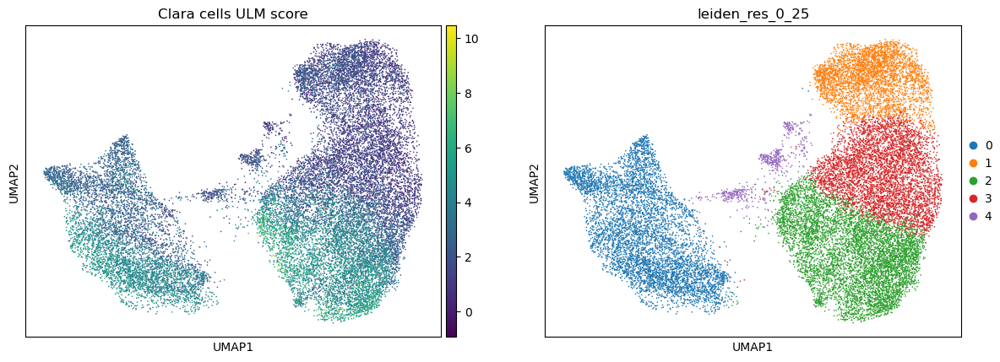

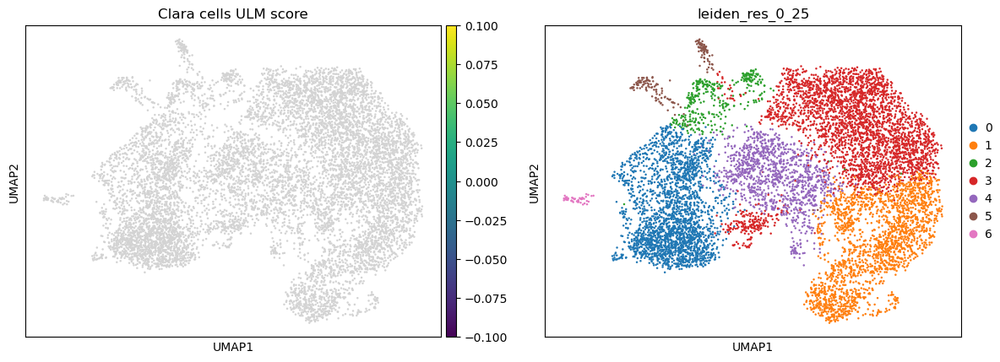

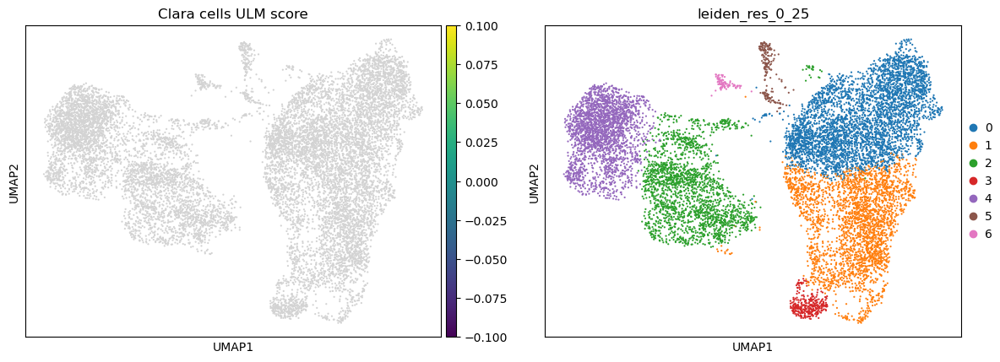

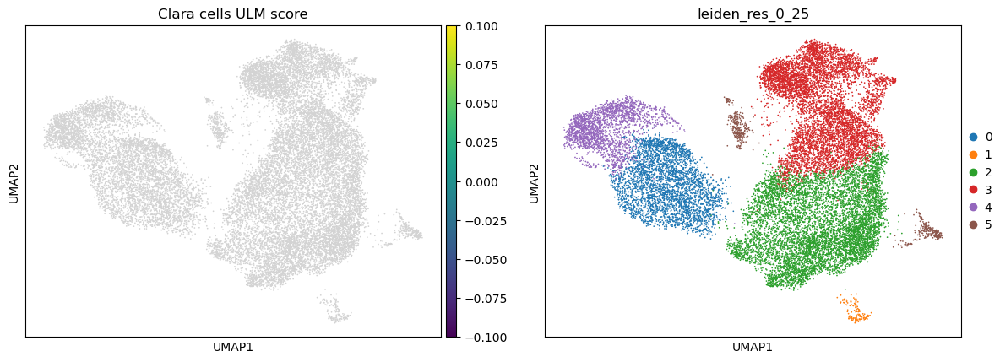

In [150]:
# Add the ULM score for "Clara cells" to .obs for plotting
if 'Clara cells' in mock_adata.obsm['score_ulm'].columns:
    mock_adata.obs['Clara cells ULM score'] = mock_adata.obsm['score_ulm']['Clara cells']
else:
    mock_adata.obs['Clara cells ULM score'] = np.nan

if 'Clara cells' in day1_adata.obsm['score_ulm'].columns:
    day1_adata.obs['Clara cells ULM score'] = day1_adata.obsm['score_ulm']['Clara cells']
else:
    day1_adata.obs['Clara cells ULM score'] = np.nan

if 'Clara cells' in day2_adata.obsm['score_ulm'].columns:
    day2_adata.obs['Clara cells ULM score'] = day2_adata.obsm['score_ulm']['Clara cells']
else:
    day2_adata.obs['Clara cells ULM score'] = np.nan

if 'Clara cells' in day3_adata.obsm['score_ulm'].columns:
    day3_adata.obs['Clara cells ULM score'] = day3_adata.obsm['score_ulm']['Clara cells']
else:
    day3_adata.obs['Clara cells ULM score'] = np.nan

# Now plot both the ULM score and the leiden clustering
sc.pl.umap(mock_adata, color=["Clara cells ULM score", "leiden_res_0_25"])
sc.pl.umap(day1_adata, color=["Clara cells ULM score", "leiden_res_0_25"])
sc.pl.umap(day2_adata, color=["Clara cells ULM score", "leiden_res_0_25"])
sc.pl.umap(day3_adata, color=["Clara cells ULM score", "leiden_res_0_25"])

Clara cells disappear and don't come back, while ciliated cells recover and dominate. This is a key difference in how different cell types respond to SARS-CoV-2 infection

In [151]:
dict_ann_m = mock_adata_gene_rank[mock_adata_gene_rank["stat"] > 0].groupby("group").head(1).set_index("group")["name"].to_dict()

dict_ann_1 = one_adata_gene_rank[one_adata_gene_rank["stat"] > 0].groupby("group").head(1).set_index("group")["name"].to_dict()

dict_ann_2 = two_adata_gene_rank[two_adata_gene_rank["stat"] > 0].groupby("group").head(1).set_index("group")["name"].to_dict()

dict_ann_3 = three_adata_gene_rank[three_adata_gene_rank["stat"] > 0].groupby("group").head(1).set_index("group")["name"].to_dict()

In [152]:
mock_adata.obs["annotated_cell_type"] = mock_adata.obs["leiden_res_0_25"].map(dict_ann_m)
day1_adata.obs["annotated_cell_type"] = day1_adata.obs["leiden_res_0_25"].map(dict_ann_1)
day2_adata.obs["annotated_cell_type"] = day2_adata.obs["leiden_res_0_25"].map(dict_ann_2)
day3_adata.obs["annotated_cell_type"] = day3_adata.obs["leiden_res_0_25"].map(dict_ann_3)

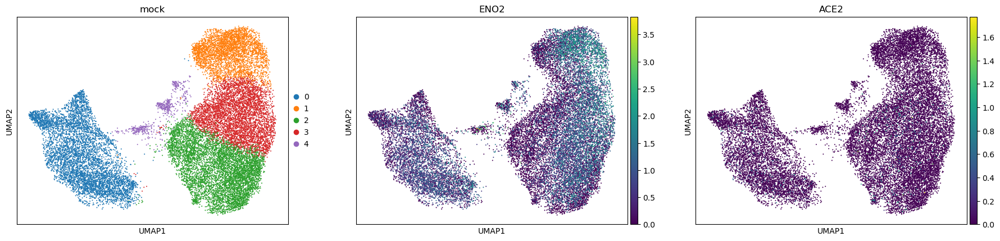

... storing 'annotated_cell_type' as categorical


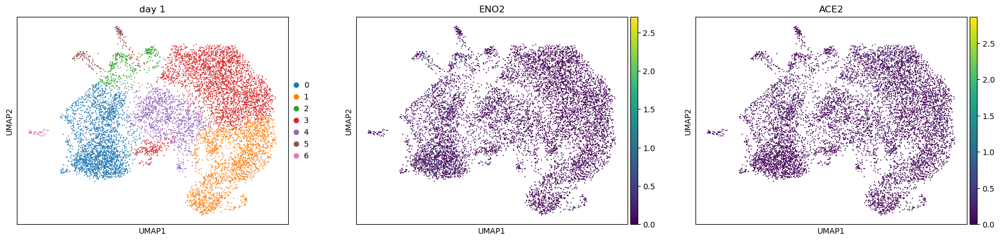

... storing 'annotated_cell_type' as categorical


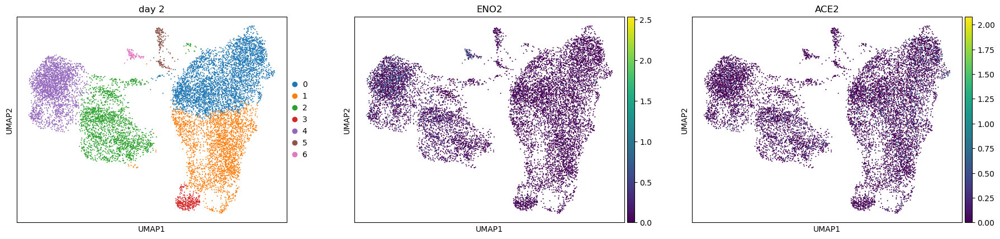

... storing 'annotated_cell_type' as categorical


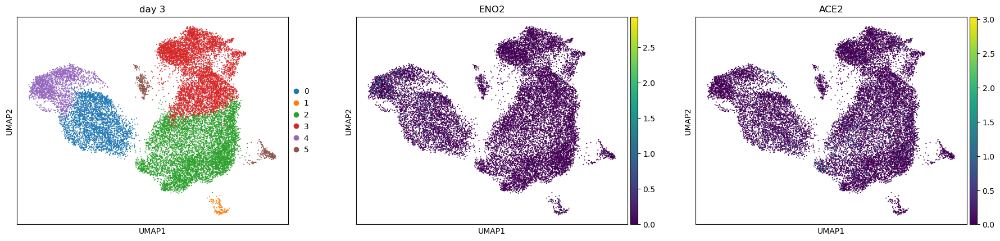

In [153]:
sc.pl.umap(
    mock_adata,
    color=['leiden_res_0_25', 'ENO2','ACE2'],
    size=8,
    title='mock'
)

sc.pl.umap(
    day1_adata,
    color=['leiden_res_0_25', 'ENO2','ACE2'],
    size=8,
    title='day 1'
)

sc.pl.umap(
    day2_adata,
    color=['leiden_res_0_25', 'ENO2','ACE2'],
    size=8,
    title='day 2'
)

sc.pl.umap(
    day3_adata,
    color=['leiden_res_0_25', 'ENO2','ACE2'],
    size=8,
    title='day 3'
)

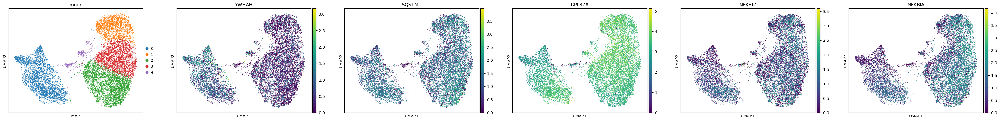

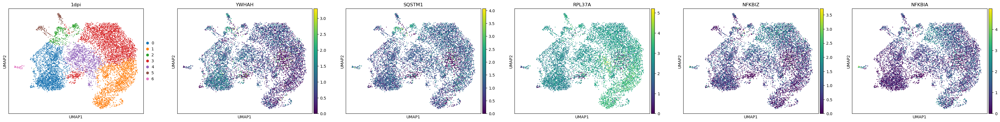

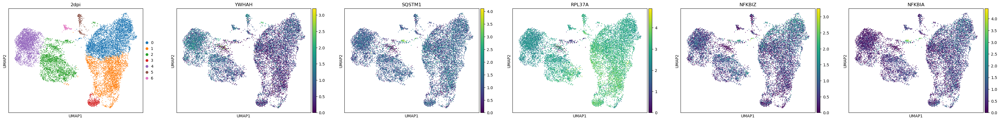

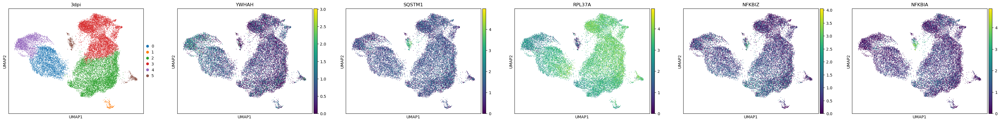

In [154]:
sc.pl.umap(
    mock_adata,
    color=['leiden_res_0_25', 'YWHAH', 'SQSTM1', 'RPL37A', 'NFKBIZ', 'NFKBIA'],
    ncols=6,
    title='mock'
)

sc.pl.umap(
    day1_adata,
    color=['leiden_res_0_25', 'YWHAH', 'SQSTM1', 'RPL37A', 'NFKBIZ', 'NFKBIA'],
    ncols=6,
    title='1dpi'
)

sc.pl.umap(
    day2_adata,
    color=['leiden_res_0_25', 'YWHAH', 'SQSTM1', 'RPL37A', 'NFKBIZ', 'NFKBIA'],
    ncols=6,
    title='2dpi'
)

sc.pl.umap(
    day3_adata,
    color=['leiden_res_0_25', 'YWHAH', 'SQSTM1', 'RPL37A', 'NFKBIZ', 'NFKBIA'],
    ncols=6,
    title='3dpi'
)

In [155]:
# mock
dict_ann_mock_raw = mock_adata_gene_rank[mock_adata_gene_rank["stat"] > 0].groupby("group").head().set_index("group")["name"].to_dict()
dict_ann_mock = {k: f"{v} ({k})" for k, v in dict_ann_mock_raw.items()}
display(dict_ann_mock)

# 1dpi
dict_ann_1dpi_raw = one_adata_gene_rank[one_adata_gene_rank["stat"] > 0].groupby("group").head().set_index("group")["name"].to_dict()
dict_ann_1dpi = {k: f"{v} ({k})" for k, v in dict_ann_1dpi_raw.items()}
display(dict_ann_1dpi)

# 2dpi
dict_ann_2dpi_raw = two_adata_gene_rank[two_adata_gene_rank["stat"] > 0].groupby("group").head().set_index("group")["name"].to_dict()
dict_ann_2dpi = {k: f"{v} ({k})" for k, v in dict_ann_2dpi_raw.items()}
display(dict_ann_2dpi)

# 3dpi
dict_ann_3dpi_raw = three_adata_gene_rank[three_adata_gene_rank["stat"] > 0].groupby("group").head().set_index("group")["name"].to_dict()
dict_ann_3dpi = {k: f"{v} ({k})" for k, v in dict_ann_3dpi_raw.items()}
display(dict_ann_3dpi)

{'0': 'Clara cells (0)',
 '1': 'Pulmonary alveolar type II cells (1)',
 '2': 'Alveolar macrophages (2)',
 '3': 'Ionocytes (3)',
 '4': 'Ciliated cells (4)'}

{'1': 'Pulmonary alveolar type II cells (1)',
 '3': 'Ionocytes (3)',
 '4': 'Pulmonary alveolar type I cells (4)',
 '5': 'Pulmonary alveolar type II cells (5)',
 '6': 'Pulmonary alveolar type II cells (6)'}

{'0': 'Ionocytes (0)',
 '3': 'Pulmonary alveolar type II cells (3)',
 '1': 'Airway goblet cells (1)',
 '5': 'Airway goblet cells (5)',
 '6': 'Airway goblet cells (6)'}

{'0': 'Pulmonary alveolar type II cells (0)',
 '2': 'Ionocytes (2)',
 '3': 'Alveolar macrophages (3)',
 '4': 'Ciliated cells (4)',
 '5': 'Alveolar macrophages (5)'}

In [156]:
# mock
mock_adata.obs["leiden_res_0_25"] = mock_adata.obs["leiden_res_0_25"].cat.rename_categories(dict_ann_mock)

# 1dpi
day1_adata.obs["leiden_res_0_25"] = day1_adata.obs["leiden_res_0_25"].cat.rename_categories(dict_ann_1dpi)

# 2dpi
day2_adata.obs["leiden_res_0_25"] = day2_adata.obs["leiden_res_0_25"].cat.rename_categories(dict_ann_2dpi)

# 3dpi
day3_adata.obs["leiden_res_0_25"] = day3_adata.obs["leiden_res_0_25"].cat.rename_categories(dict_ann_3dpi)

In [157]:
print("Performing differential expression analysis for mock_adata...")
sc.tl.rank_genes_groups(mock_adata, groupby='leiden_res_0_25', method='wilcoxon', rankby_abs=True, key_added='rank_genes_groups_mock')
print("Done with mock_adata.\nPerforming differential expression analysis for day1_adata...")
sc.tl.rank_genes_groups(day1_adata, groupby='leiden_res_0_25', method='wilcoxon', rankby_abs=True, key_added='rank_genes_groups_1dpi')
print("Done with day1_adata.\nPerforming differential expression analysis for day2_adata...")
sc.tl.rank_genes_groups(day2_adata, groupby='leiden_res_0_25', method='wilcoxon', rankby_abs=True, key_added='rank_genes_groups_2dpi')
print("Done with day2_adata.\nPerforming differential expression analysis for day3_adata...")
sc.tl.rank_genes_groups(day3_adata, groupby='leiden_res_0_25', method='wilcoxon', rankby_abs=True, key_added='rank_genes_groups_3dpi')
print("Done with day3_adata.")

Performing differential expression analysis for mock_adata...
Done with mock_adata.
Performing differential expression analysis for day1_adata...
Done with day1_adata.
Performing differential expression analysis for day2_adata...
Done with day2_adata.
Performing differential expression analysis for day3_adata...
Done with day3_adata.


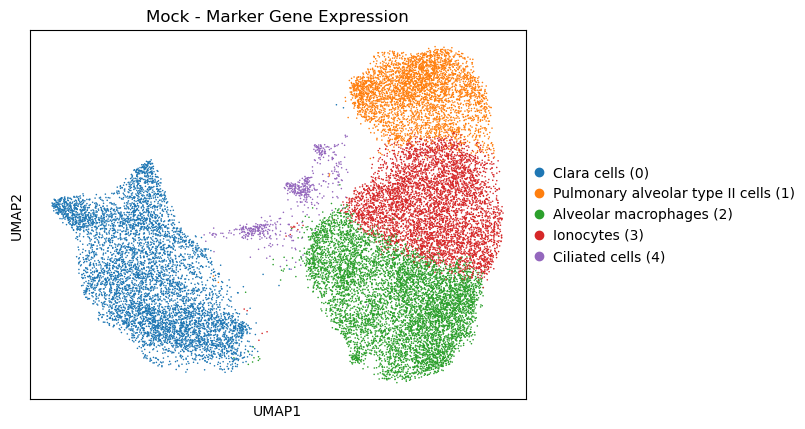

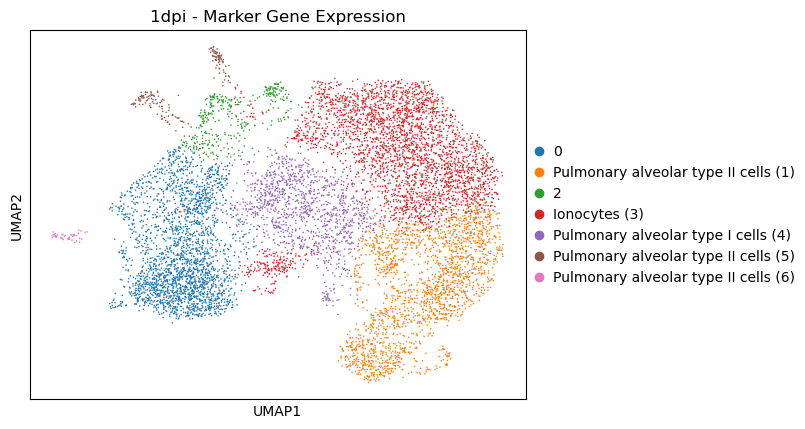

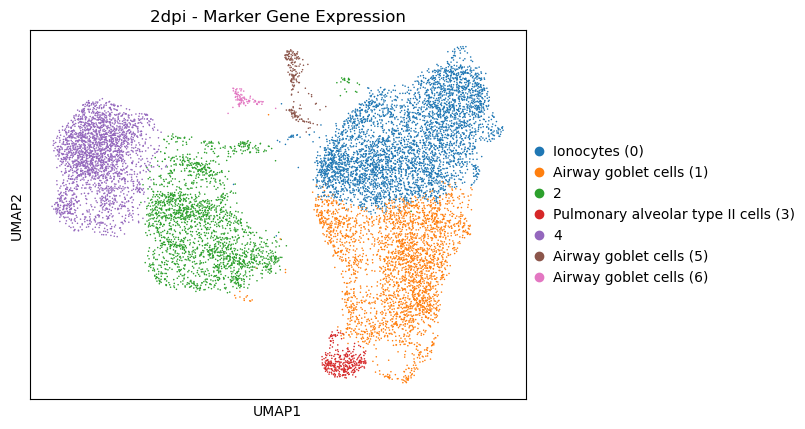

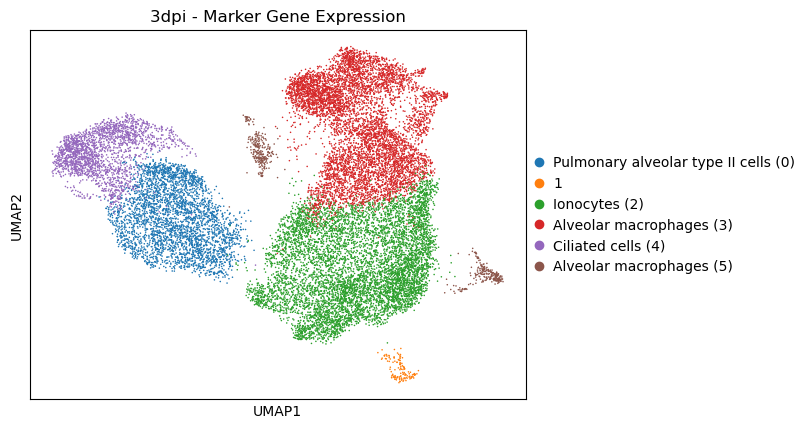

In [158]:
# Visualisation of cell annotation
# Leiden clustering identifies transcriptionally similar cell groups.
# This helps distinguish infected vs. bystander cell populations across infection stages.

# mock
sc.pl.umap(
    mock_adata,
    color=["leiden_res_0_25"],
    ncols=3,
    title='Mock - Marker Gene Expression',
    size=5
)

# 1dpi
sc.pl.umap(
    day1_adata,
    color=["leiden_res_0_25"],
    ncols=3,
    title='1dpi - Marker Gene Expression',
    size=5
)

# 2dpi
sc.pl.umap(
    day2_adata,
    color=["leiden_res_0_25"],
    ncols=3,
    title='2dpi - Marker Gene Expression',
    size=5
)

# 3dpi
sc.pl.umap(
    day3_adata,
    color=["leiden_res_0_25"],
    ncols=3,
    title='3dpi - Marker Gene Expression',
    size=5
)

In [159]:
sc.tl.paga(mock_adata, groups='leiden_res_0_25')
sc.tl.paga(day1_adata, groups='leiden_res_0_25')
sc.tl.paga(day2_adata, groups='leiden_res_0_25')
sc.tl.paga(day3_adata, groups='leiden_res_0_25')


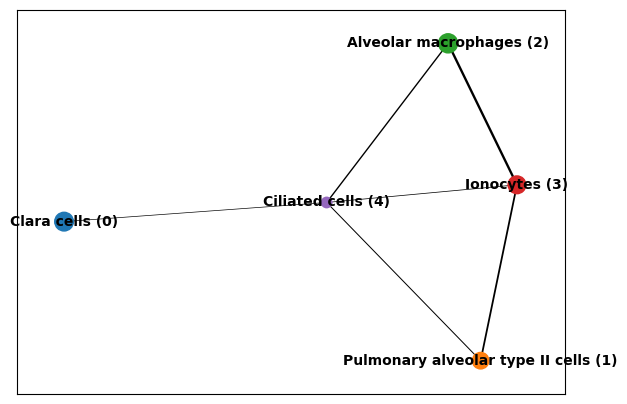

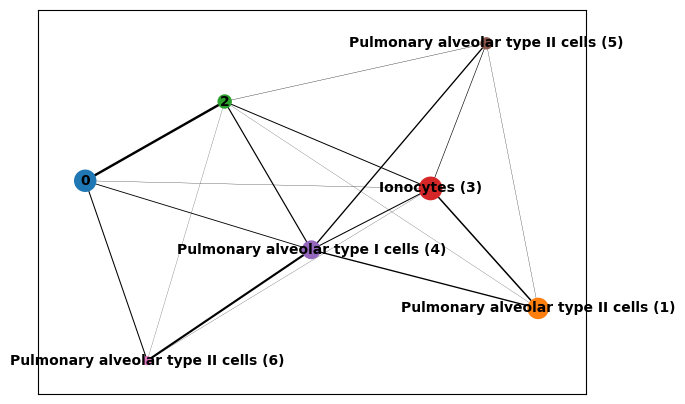

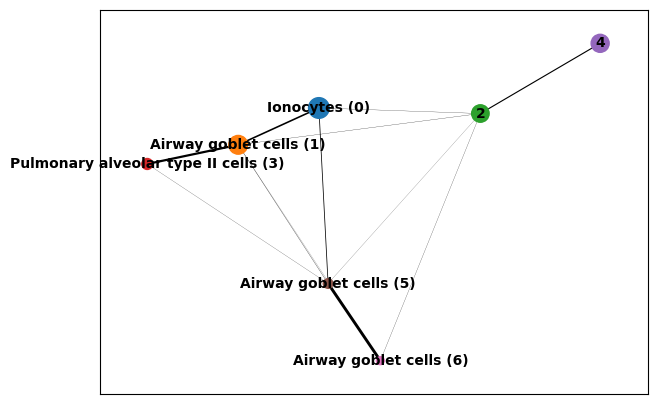

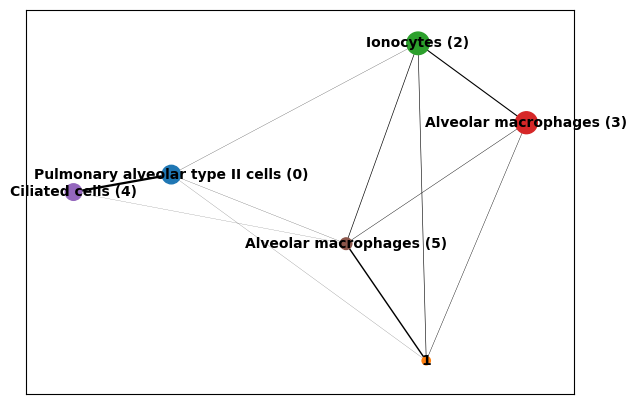

In [160]:

sc.pl.paga(mock_adata, color='leiden_res_0_25')
sc.pl.paga(day1_adata, color='leiden_res_0_25')
sc.pl.paga(day2_adata, color='leiden_res_0_25')
sc.pl.paga(day3_adata, color='leiden_res_0_25')